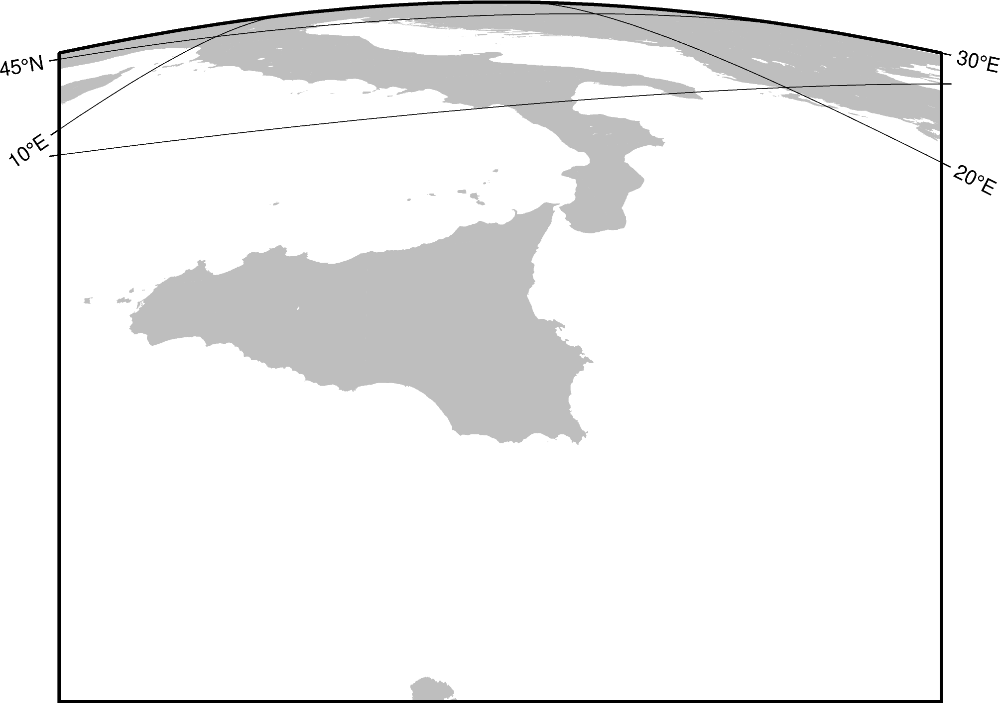

In [ ]:
import pygmt

fig = pygmt.Figure()
fig.coast(
    projection="G14.5/36/15c+a12+t45+v60/60+w0+z200",
    region="g",
    frame=["x10g10", "y5g5"],
    land="gray",
)
fig.show()



/tmp/ipykernel_3416673/2053388696.py:37: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(grid=grid, interval=250, annotation=500,limit=[-3500, -10])
/tmp/ipykernel_3416673/2053388696.py:38: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(grid=grid, interval=100, annotation=100,limit=[-101, -99])
/tmp/ipykernel_3416673/2053388696.py:39: FutureWarning: The 'interval' parameter has been deprecated since v0.12.0 and will be removed in v0.16.0. Please use 'levels' instead.
  fig.grdcontour(grid=grid, interval=50,limit=[-51, -49],pen="0.75p,Grey36,--",label_placement="D12m",annotation='50')
plot [WARNING]: Length <unit> r not supported - revert to default unit [cm]
plot [WARNING]: 0.15+ not a valid number and may not be decoded properly.


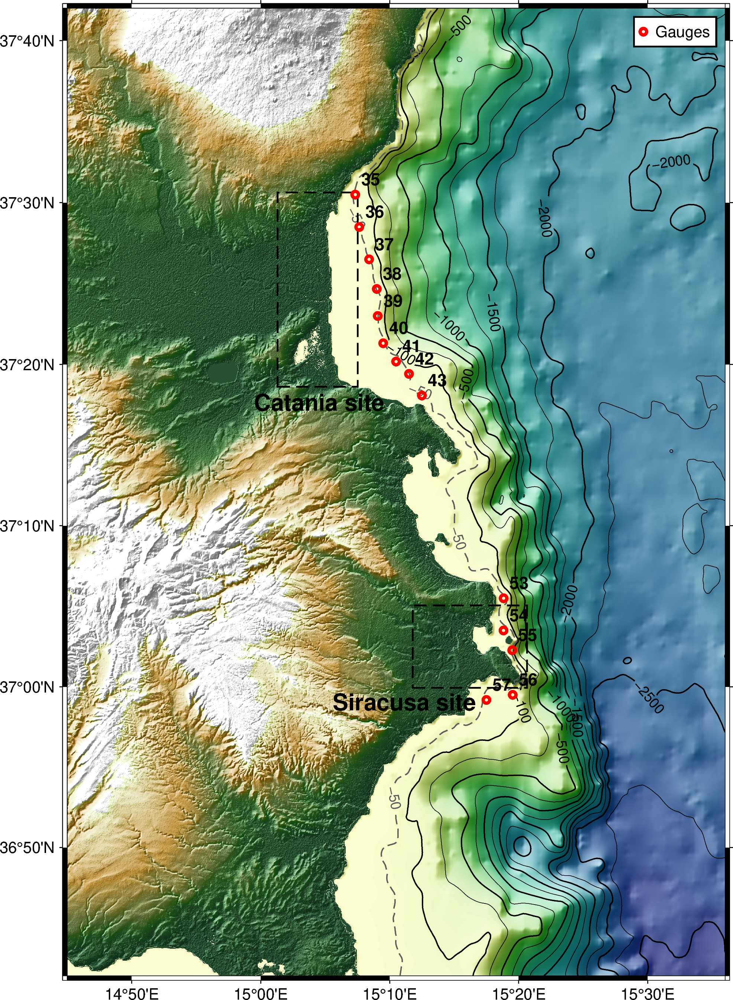

In [1]:
import pygmt
import xarray as xr
import rioxarray as rxr 
import pandas as pd
import numpy as np


# Load the grid
grid_CT = xr.open_dataset('../../data/processed/CT_defbathy.nc',engine='netcdf4')
grid_SR = xr.open_dataset('../../data/processed/SR_defbathy.nc',engine='netcdf4')
# grid_bathy = rxr.open_rasterio('../../resources/gis/bathy/F6_2022_mean.tif')
# grid_topo = rxr.open_rasterio('../../resources/gis/bathy/output_COP30.tif')

# #use geotiff file for bathymetry instead
# grid_bathy = grid_bathy.rio.write_crs("EPSG:4326")
# grid_topo = grid_topo.rio.write_crs("EPSG:4526")

grid = pygmt.datasets.load_earth_relief(
    resolution="01s", region=[14.75, 15.6,36.7, 37.7], registration="gridline"
)
# # #hillshade
# dgrid = pygmt.grdgradient(grid=grid_bathy, radiance=[270, 30])
# hgrid = pygmt.grdgradient(grid=grid_topo, radiance=[270, 30])

#read offshore points from 
gauges = pd.read_csv('../../resources/raw/pois_depth.csv',sep=',')

CT_gauges = list(range(35,44))
SR_gagues = list(range(53,58))

#combine both
selected_gauges =  gauges.iloc[CT_gauges + SR_gagues]

fig = pygmt.Figure()
pygmt.makecpt(cmap="cmocean/topo", series=[-4000, 500])
fig.grdimage(grid=grid, frame="a", projection="M15c", cmap=True,shading=True)
fig.grdcontour(grid=grid, interval=250, annotation=500,limit=[-3500, -10])
fig.grdcontour(grid=grid, interval=100, annotation=100,limit=[-101, -99])
fig.grdcontour(grid=grid, interval=50,limit=[-51, -49],pen="0.75p,Grey36,--",label_placement="D12m",annotation='50')
#plot CT and SR grids area as rectangles
fig.plot(
    data = np.array([[float(grid_CT['x'].min()),
                    float(grid_CT['y'].min()),
                    float(grid_CT['x'].max()),
                    float(grid_CT['y'].max())]]),
    style='r+s',
    pen= "1p,black,-",)

fig.plot(
    data = np.array([[float(grid_SR['x'].min()),
                    float(grid_SR['y'].min()),
                    float(grid_SR['x'].max()),
                    float(grid_SR['y'].max())]]),
    style='r+s',
    pen= "1p,black,-",)

fig.plot(
    x=selected_gauges['lon'],
    y=selected_gauges['lat'],
    style="c0.15+r",
    pen="2p,red",
    label="Gauges ",
)

#add annotations for gauges
for i in range(len(selected_gauges)):
    fig.text(
        x=selected_gauges['lon'].iloc[i],
        y=selected_gauges['lat'].iloc[i],
        text=selected_gauges['id'].iloc[i],
        font="11p,Helvetica-Bold,black",
        justify="CM",
        offset="0.35c",
    )

fig.text(
    x=15.07,    
    y=37.29,
    text="Catania site",
    font="15p,Helvetica-Bold,black",
    justify="CM",
    offset="0.1c",
)

fig.text(
    x=15.18,    
    y=36.98,
    text="Siracusa site",
    font="15p,Helvetica-Bold,black",
    justify="CM",
    offset="0.1c",
)

# fig.colorbar(frame=["a500", "x+lElevation", "y+lm"])
fig.legend()
fig.savefig('./plots/pygmt_regions.png',dpi=300)
fig.show()


makecpt [WARNING]: cmocean/topo is a discrete CPT. You can stretch it (-T<min>/<max>) but not interpolate it (-T<min>/<max>/<inc>).
makecpt [WARNING]: Selecting the given range and ignoring the increment setting.


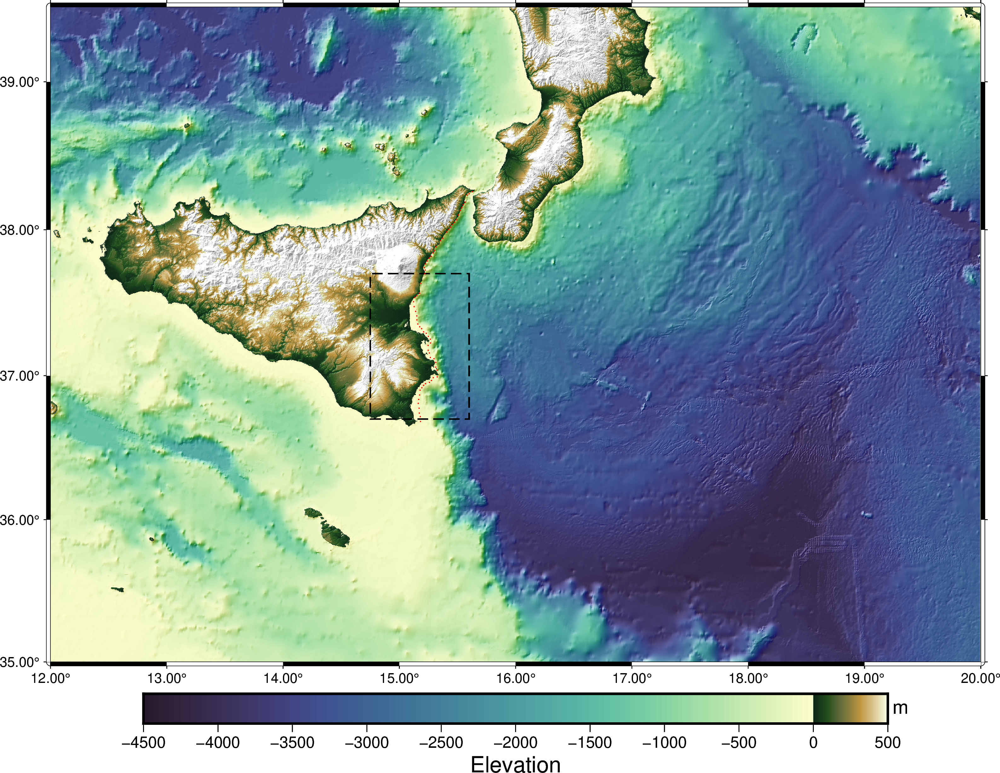

In [3]:
import pygmt
import xarray as xr
import rioxarray as rxr 
import pandas as pd
import numpy as np

# Load the grid
grid = pygmt.datasets.load_earth_relief(
    resolution="03s", region=[12,20,35,39.5], registration="gridline"
)
#read offshore points from 
gauges = pd.read_csv('../../resources/raw/pois_depth.csv',sep=',')[5:71]
fig = pygmt.Figure()
with pygmt.config(MAP_FRAME_TYPE="fancy+",FORMAT_GEO_MAP="ddd.xx"):
    pygmt.makecpt(cmap="cmocean/topo", series=[-4500, 500,10],continuous=False)
    fig.grdimage(grid=grid, frame="a", projection="M25c", cmap=True,shading=True)
    #plot region 14.75, 15.6,36.7, 37.7 area as rectangles
    fig.plot(data = np.array([[14.75, 36.7,
                15.6, 37.7]]),
                style='r+s',
                pen= "1p,black,--",)
    fig.plot(
        x=gauges['lon'],
        y=gauges['lat'],
        style="p0.03c", 
        fill="red",
        label="Gauges ",
    )
    fig.colorbar(frame=["a500", "x+lElevation", "y+lm"])
    fig.savefig('./plots/pygmt_regions_large.png',dpi=300)
fig.show()


Sample predictions

In [1]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import numpy as np
import matplotlib.colors as mplcolors
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from sklearn.metrics import r2_score
import xarray as xr
from scipy.ndimage import gaussian_filter

#select particular representative gauge
# Load file
MLDir = '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami' 
SimDir = "/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/simu/"
reg = 'CT'
if reg == 'CT':
    columnname = str(38)
    list_size = ['892','1658','3454','7071']  
    control_points =  [[37.5022,15.0960],
            [37.48876,15.08936],
            [37.47193,15.07816],
            [37.46273,15.08527],
            [37.46252,15.08587],
            [37.45312,15.07874],
            [37.42821,15.08506],
            [37.40958,15.08075],
            [37.38595,15.08539],
            [37.35084,15.08575],
            [37.33049,15.07029],
            [37.40675,15.05037]]
    
elif reg == 'SR':
    columnname = str(54)
    list_size = ['961','1773','3669','6941']
    control_points = [[37.01,15.29],
            [37.06757,15.28709],
            [37.05266,15.26536],
            [37.03211,15.28632]]
mask_size = list_size[0]
train_size = list_size[1]

#predictions and post processed predictions
idx= np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/lat_lon_idx_{reg}_{mask_size}.npy')
pred_depths = np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/PTHA/pred_d_{train_size}_direct.npy')
true_depths = np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/PTHA/true_d_53550.npy')
eve_perf = pd.read_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/out/model_direct_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')    
grid_score = pd.read_csv('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/PTHA/_Grid_scores_1658.txt',sep=',')

BS_manning003/E01267N3753E01646N3535-BS-M809_E01502N3737_D144_S022D70R270_A006995_S075 
 29746


/tmp/ipykernel_3062498/717748048.py:115: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


PS_manning003/E02020N3739E02658N3366-PS-Str_PYes_Var-M902_E02417N3454_S001 
 17496
BS_manning003/E01267N3753E01646N3535-BS-M809_E01547N3670_D010_S337D70R270_A006995_S075 
 45486
BS_manning003/E01267N3753E01646N3535-BS-M809_E01495N3692_D010_S022D50R270_A006995_S075 
 30440
BS_4-8_manning003/E01267N3753E01646N3535-BS-M809_E01502N3737_D010_S067D90R090_A006995_S075 
 50682


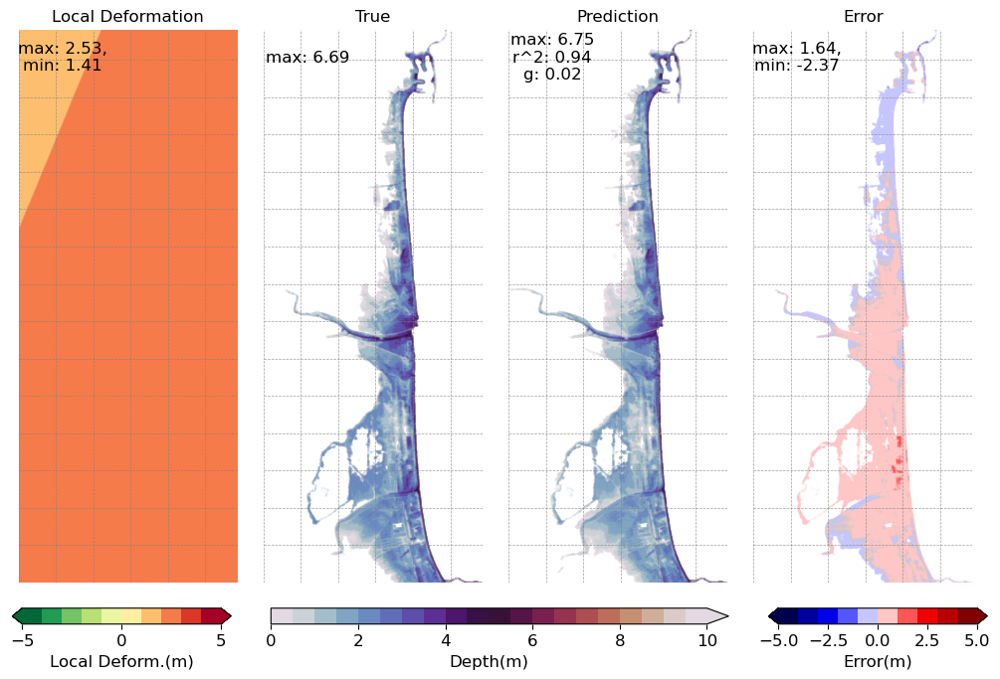

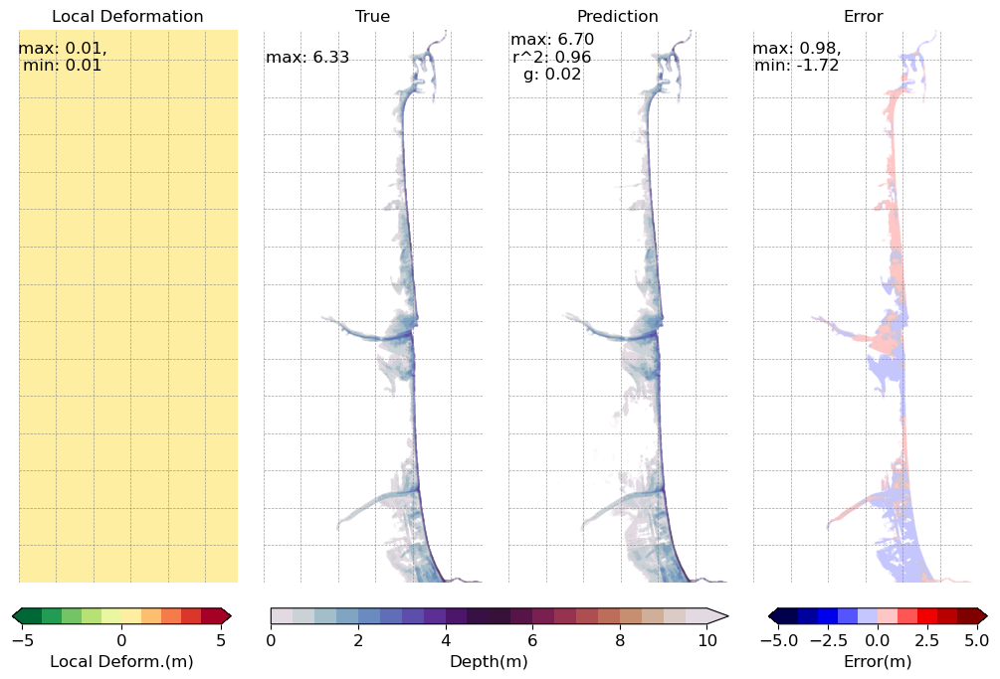

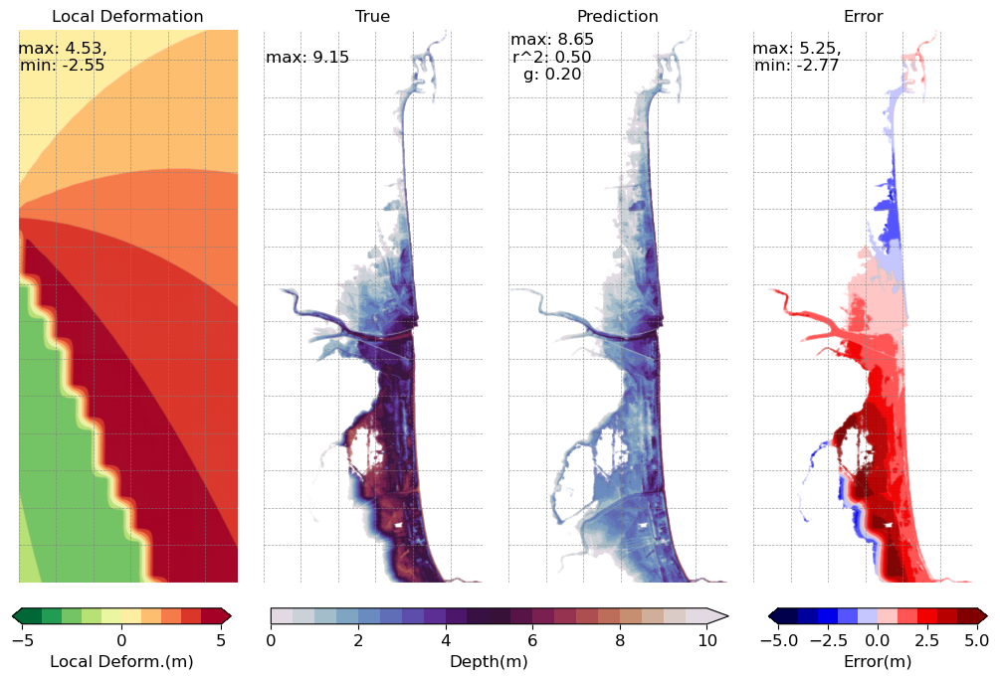

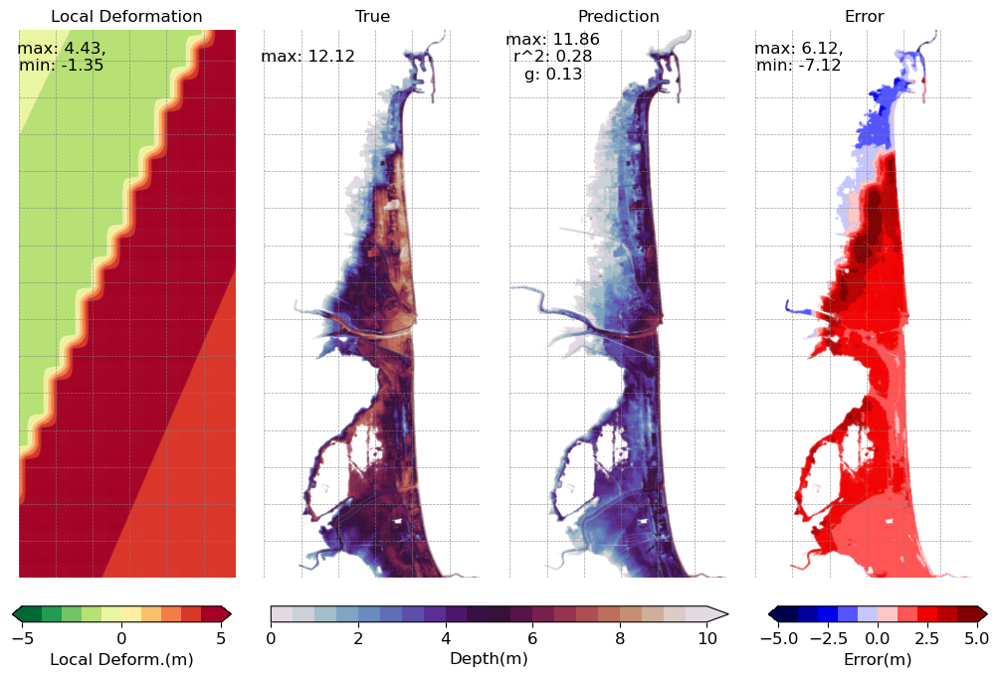

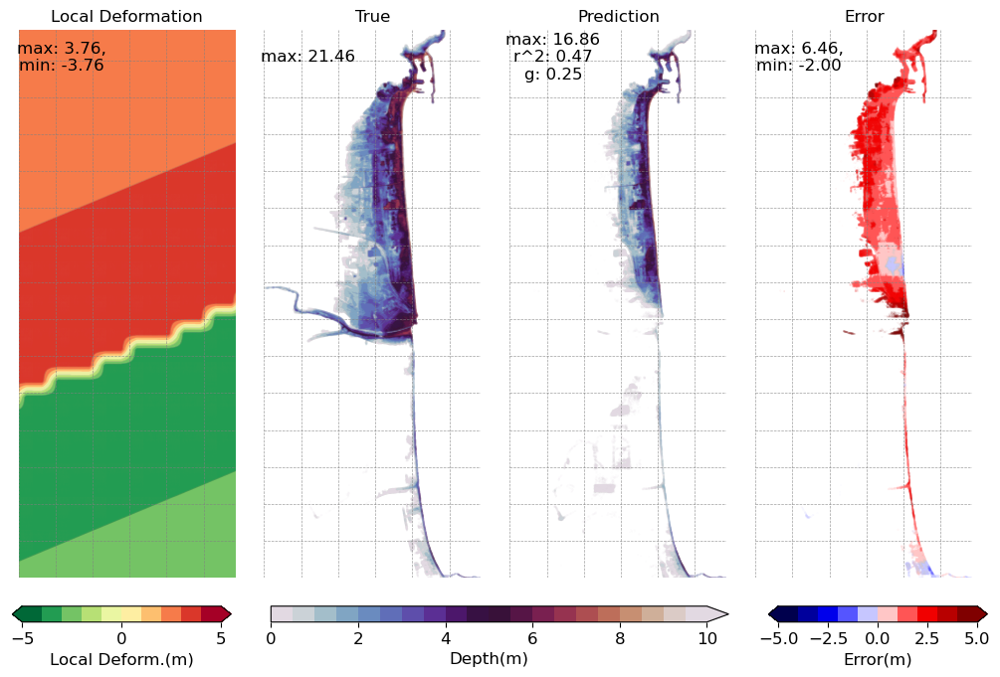

In [8]:
ids = [
        'BS_manning003/E01267N3753E01646N3535-BS-M809_E01502N3737_D144_S022D70R270_A006995_S075',
        'PS_manning003/E02020N3739E02658N3366-PS-Str_PYes_Var-M902_E02417N3454_S001',
        'BS_manning003/E01267N3753E01646N3535-BS-M809_E01547N3670_D010_S337D70R270_A006995_S075',
        'BS_manning003/E01267N3753E01646N3535-BS-M809_E01495N3692_D010_S022D50R270_A006995_S075',
        'BS_4-8_manning003/E01267N3753E01646N3535-BS-M809_E01502N3737_D010_S067D90R090_A006995_S075'
        ]
for id in ids:
    eve_id = np.loadtxt('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/sample_events53550.txt',dtype='str')
    eve = np.where(eve_id==id)[0][0]
    print(id,'\n',eve)
    # eve=32145
    # id =eve_id[eve]

    #read dZ file and grid location file to extract location information
    data2plot = xr.open_dataset(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/simu/{id}/{reg}_deformation.nc')
    dz = data2plot['deformation'].values
    # (948 x 1300)
    # x = data2plot['x'].values #1300
    # y = data2plot['y'].values #948

    x = np.linspace(0,dz.shape[1],dz.shape[1])
    y = np.linspace(0,dz.shape[0],dz.shape[0])

    #create list of x,y,dz
    xy_mesh = np.meshgrid(x,y)
    # dz_smooth = gaussian_filter(dz, sigma=50)
    dz_smooth = dz
    x_list,y_list = xy_mesh[0].flatten(),xy_mesh[1].flatten()
    dz_list = dz.flatten()

    pred=pred_depths[eve]
    true=true_depths[eve]

    fig, axs = plt.subplots(1, 4, figsize=(10,8))
    axs = axs.ravel()

    # Plot performance variable values
    cmap_depth = plt.get_cmap('twilight',20)
    cmap_error = plt.get_cmap('seismic', 10)
    cmap_dz = plt.get_cmap('RdYlGn_r',10)

    # Set NaN for rows where count_test is less than 1
    true=true/100
    pred=pred/100
    pred= np.where(pred < 0.1, np.nan, pred)
    true= np.where(true < 0.1, np.nan, true)
    error1=true-pred
    error2=pred-true
    error = np.where(np.abs(error1) < np.abs(error2), error1, -error2)
    error= np.where((error < 0.01) & (error > -0.01), np.nan, error)

    depth_max = max(np.nanmax(pred),np.nanmax(true))
    error_max = round(np.nanmax(np.abs(error)))
    dz_max = round(np.nanmax(np.abs(dz_smooth)))


    # Local Deformation
    DZ = axs[0].scatter(x_list,y_list, c=dz_smooth, s=0.0005, cmap=cmap_dz,
                        vmin=-5, vmax=5,alpha=1)
    axs[0].text(0.2, 0.95, f'max: {np.nanmax(dz_smooth):.2f},\nmin: {np.nanmin(dz_smooth):.2f}',
                horizontalalignment='center', verticalalignment='center',   
                transform=axs[0].transAxes, fontsize=12)
    axs[0].set_title('Local Deformation')

    # True
    TR = axs[1].scatter(idx[:, 1], idx[:, 0], c=true, s=0.0005, cmap=cmap_depth,
                         vmin=0, vmax=10,alpha=1)
    axs[1].text(0.2, 0.95, f'max: {np.nanmax(true):.2f}', 
                horizontalalignment='center', verticalalignment='center',
                transform=axs[1].transAxes, fontsize=12)
    axs[1].set_title('True')

    # Pred
    PR = axs[2].scatter(idx[:, 1], idx[:, 0], c=pred, s=0.0005, cmap=cmap_depth,
                         vmin=0, vmax=10,alpha=1)
    axs[2].text(0.2, 0.95, f'max: {np.nanmax(pred):.2f}\nr^2: {eve_perf["r2"].iloc[eve]:.2f}\ng: {eve_perf["g"].iloc[eve]:.2f}',
                horizontalalignment='center', verticalalignment='center',   
                transform=axs[2].transAxes, fontsize=12)
    axs[2].set_title('Prediction')

    # Error
    ER = axs[3].scatter(idx[:, 1], idx[:, 0], c=error, s=0.0005, cmap=cmap_error,
                        vmin=-5,vmax=5,alpha=1)
    axs[3].text(0.2, 0.95, f'max: {np.nanmax(error):.2f},\nmin: {np.nanmin(error):.2f}',
                horizontalalignment='center', verticalalignment='center',
                transform=axs[3].transAxes, fontsize=12)
    axs[3].set_title('Error')


    # Set axis scale as equal and add gridlines
    for ax in axs:
        #keep gridlines but turn off axis borders and ticks
        ax.set_aspect('equal')
        ax.set_axis_off()
        ax.set_xlim([0, max(idx[:, 1])])
        ax.set_ylim([0, max(idx[:, 0])])
        ax.hlines(y=np.arange(0, max(idx[:, 0]), 150), xmin=0, xmax=max(idx[:, 1]), color='grey', linestyle='--', linewidth=0.5,alpha=0.75)
        ax.vlines(x=np.arange(0, max(idx[:, 1]), 150), ymin=0, ymax=max(idx[:, 0]), color='grey', linestyle='--', linewidth=0.5,alpha=0.75)

    # Add a common colorbar for the whole fig using axes transform
    cbar_dz = fig.add_axes([0.02, 0.1, 0.22, 0.02])
    cbar_dep = fig.add_axes([0.28, 0.1, 0.46, 0.02])
    cbar_err = fig.add_axes([0.78, 0.1, 0.22, 0.02])

    cbar1 = fig.colorbar(TR, cax=cbar_dep, orientation ='horizontal',extend='max')
    cbar2 = fig.colorbar(ER, cax=cbar_err, orientation ='horizontal',extend='both')
    cbar3 = fig.colorbar(DZ, cax=cbar_dz, orientation ='horizontal',extend='both')
    cbar1.ax.tick_params(labelsize=12)
    cbar2.ax.tick_params(labelsize=12)
    cbar3.ax.tick_params(labelsize=12)
    cbar1.set_label('Depth(m)', fontsize=12)
    cbar2.set_label('Error(m)', fontsize=12)
    cbar3.set_label('Local Deform.(m)', fontsize=12)
    plt.tight_layout()
    plt.savefig(f'plots/Sample_TPE_{train_size}_{reg}_{str(eve)}_direct.png', dpi=300, bbox_inches='tight', pad_inches=0.1)

BS_manning003/E01267N3753E01646N3535-BS-M809_E01523N3692_D010_S292D50R270_A006995_S075 
 29974


/tmp/ipykernel_2880321/1619659859.py:111: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


PS_manning003/E02020N3739E02658N3366-PS-Str_PYes_Var-M895_E02351N3465_S003 
 7610
BS_manning003/E01267N3753E01646N3535-BS-M809_E01547N3670_D010_S337D70R270_A006995_S075 
 45486
BS_4-8_manning003/E01267N3753E01646N3535-BS-M809_E01551N3692_D010_S112D90R090_A006995_S075 
 51052


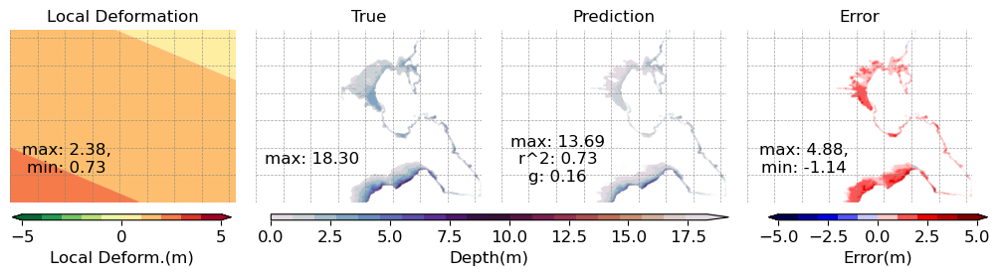

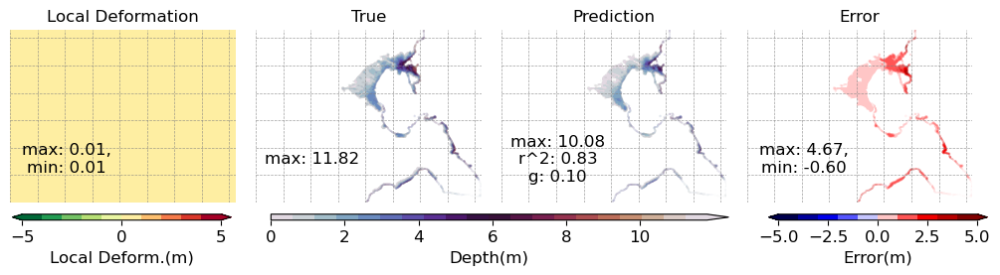

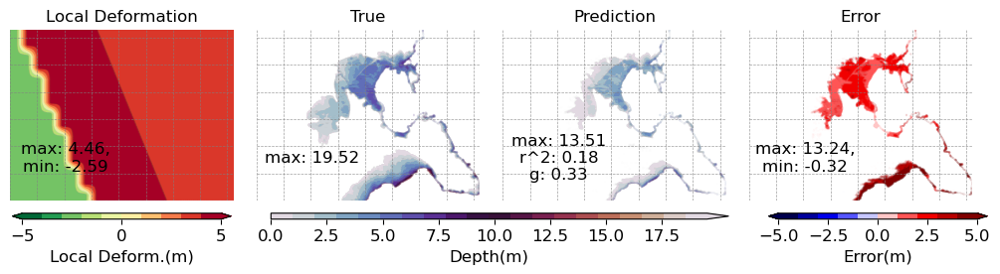

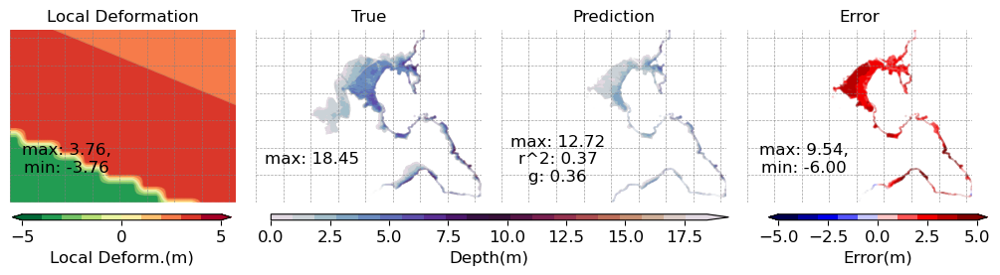

In [8]:
ids = [
        'BS_manning003/E01267N3753E01646N3535-BS-M809_E01523N3692_D010_S292D50R270_A006995_S075',
        'PS_manning003/E02020N3739E02658N3366-PS-Str_PYes_Var-M895_E02351N3465_S003',
        'BS_manning003/E01267N3753E01646N3535-BS-M809_E01547N3670_D010_S337D70R270_A006995_S075',
        'BS_4-8_manning003/E01267N3753E01646N3535-BS-M809_E01551N3692_D010_S112D90R090_A006995_S075',
        ]
for id in ids:
    eve_id = np.loadtxt('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/sample_events53550.txt',dtype='str')
    eve = np.where(eve_id==id)[0][0]
    print(id,'\n',eve)
    # eve=32145
    # id =eve_id[eve]

    #read dZ file and grid location file to extract location information
    data2plot = xr.open_dataset(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/simu/{id}/{reg}_deformation.nc')
    dz = data2plot['deformation'].values
    # (948 x 1300)
    # x = data2plot['x'].values #1300
    # y = data2plot['y'].values #948

    x = np.linspace(0,dz.shape[1],dz.shape[1])
    y = np.linspace(0,dz.shape[0],dz.shape[0])

    #create list of x,y,dz
    xy_mesh = np.meshgrid(x,y)
    # dz_smooth = gaussian_filter(dz, sigma=50)
    dz_smooth = dz
    x_list,y_list = xy_mesh[0].flatten(),xy_mesh[1].flatten()
    dz_list = dz.flatten()

    pred=pred_depths[eve]
    true=true_depths[eve]

    fig, axs = plt.subplots(1, 4, figsize=(10,3))
    axs = axs.ravel()

    # Plot performance variable values
    cmap_depth = plt.get_cmap('twilight',20)
    cmap_error = plt.get_cmap('seismic', 10)
    cmap_dz = plt.get_cmap('RdYlGn_r',10)

    # Set NaN for rows where count_test is less than 1
    true=true/100
    pred=pred/100
    pred= np.where(pred < 0.1, np.nan, pred)
    true= np.where(true < 0.1, np.nan, true)
    error1=true-pred
    error2=pred-true
    error = np.where(np.abs(error1) < np.abs(error2), error1, -error2)
    error= np.where((error < 0.01) & (error > -0.01), np.nan, error)

    depth_max = max(np.nanmax(pred),np.nanmax(true))

    error_max = round(np.nanmax(np.abs(error)))
    dz_max = round(np.nanmax(np.abs(dz_smooth)))

    # Local Deformation
    DZ = axs[0].scatter(x_list,y_list, c=dz_smooth, s=0.0001, cmap=cmap_dz,
                        vmin=-5, vmax=5,alpha=1)
    axs[0].text(0.25, 0.25, f'max: {np.nanmax(dz_smooth):.2f},\nmin: {np.nanmin(dz_smooth):.2f}',
                horizontalalignment='center', verticalalignment='center',
                transform=axs[0].transAxes, fontsize=12)
    axs[0].set_title('Local Deformation')

    # True
    TR = axs[1].scatter(idx[:, 1], idx[:, 0], c=true, s=0.0001, cmap=cmap_depth, 
                        vmin=0, vmax=depth_max,alpha=1)
    axs[1].text(0.25, 0.25, f'max: {np.nanmax(true):.2f}',
                horizontalalignment='center', verticalalignment='center',
                transform=axs[1].transAxes, fontsize=12)
    axs[1].set_title('True')

    # Pred
    PR = axs[2].scatter(idx[:, 1], idx[:, 0], c=pred, s=0.0001, cmap=cmap_depth,
                         vmin=0, vmax=depth_max,alpha=1)
    axs[2].text(0.25, 0.25, f'max: {np.nanmax(pred):.2f}\nr^2: {eve_perf["r2"].iloc[eve]:.2f}\ng: {eve_perf["g"].iloc[eve]:.2f}',
                horizontalalignment='center', verticalalignment='center',
                transform=axs[2].transAxes, fontsize=12)
    axs[2].set_title('Prediction')

    # Error
    ER = axs[3].scatter(idx[:, 1], idx[:, 0], c=error, s=0.0001, cmap=cmap_error,
                        vmin=-5,vmax=5,alpha=1)
    axs[3].text(0.25, 0.25, f'max: {np.nanmax(error):.2f},\nmin: {np.nanmin(error):.2f}',
                horizontalalignment='center', verticalalignment='center',
                transform=axs[3].transAxes, fontsize=12)
    axs[3].set_title('Error')

    # Set axis scale as equal and add gridlines
    for ax in axs:
        #keep gridlines but turn off axis borders and ticks
        ax.set_aspect('equal')
        ax.set_axis_off()
        ax.set_xlim([0, max(idx[:, 1])])
        ax.set_ylim([0, max(idx[:, 0])])
        ax.hlines(y=np.arange(0, max(idx[:, 0]), 150), xmin=0, xmax=max(idx[:, 1]), color='grey', linestyle='--', linewidth=0.5,alpha=0.75)
        ax.vlines(x=np.arange(0, max(idx[:, 1]), 150), ymin=0, ymax=max(idx[:, 0]), color='grey', linestyle='--', linewidth=0.5,alpha=0.75)

    # Add a common colorbar for the whole fig using axes transform
    cbar_dz = fig.add_axes([0.02, 0.15, 0.22, 0.02])
    cbar_dep = fig.add_axes([0.28, 0.15, 0.46, 0.02])
    cbar_err = fig.add_axes([0.78, 0.15, 0.22, 0.02])

    cbar1 = fig.colorbar(TR, cax=cbar_dep, orientation ='horizontal',extend='max')
    cbar2 = fig.colorbar(ER, cax=cbar_err, orientation ='horizontal',extend='both')
    cbar3 = fig.colorbar(DZ, cax=cbar_dz, orientation ='horizontal',extend='both')
    cbar1.ax.tick_params(labelsize=12)
    cbar2.ax.tick_params(labelsize=12)
    cbar3.ax.tick_params(labelsize=12)
    cbar1.set_label('Depth(m)', fontsize=12)
    cbar2.set_label('Error(m)', fontsize=12)
    cbar3.set_label('Local Deform.(m)', fontsize=12)
    plt.tight_layout()
    plt.savefig(f'plots/Sample_TPE_{train_size}_{reg}_{str(eve)}_nodeform.png', dpi=300, bbox_inches='tight', pad_inches=0.1)

Error and Perf Map

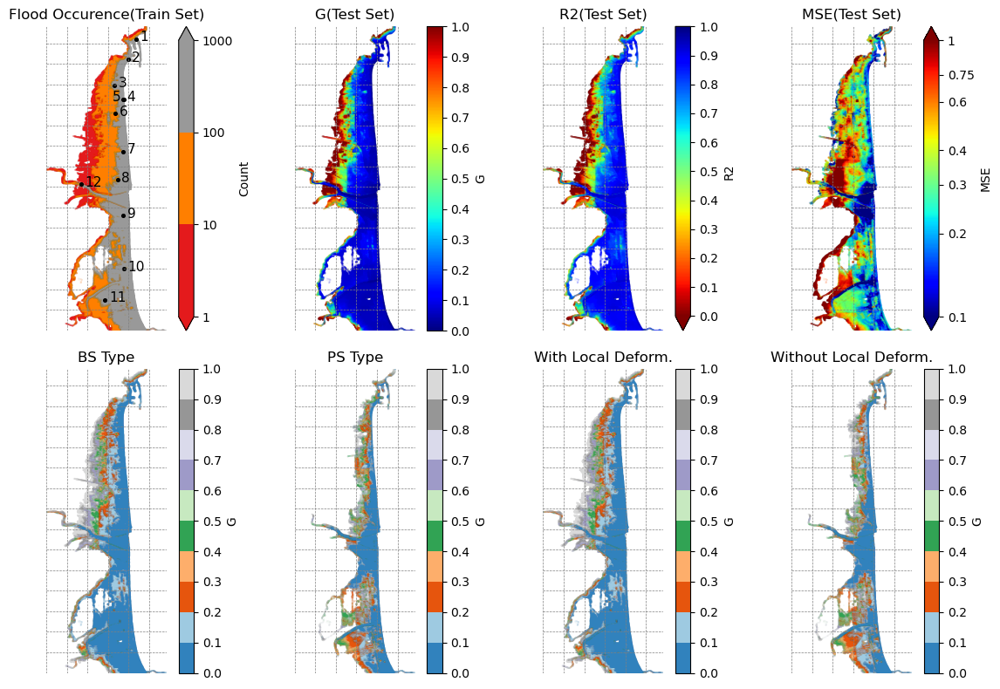

In [1]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import numpy as np
import matplotlib.colors as mplcolors
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from sklearn.metrics import r2_score
import xarray as xr


#select particular representative gauge
reg = 'CT'
list_size = ['892','1658','3454','7071']   
columnname = str(38)
mask_size = '892'
train_size = list_size[1]
idx= np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/lat_lon_idx_{reg}_{mask_size}.npy')
idx_val = pd.read_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/PTHA/_Grid_scores_{train_size}.txt', sep=",")

#add columns to to the idx array
nflood_grids = len(idx)

# Using enumerate to add index to the list of coordinates
control_points =  [[37.5022,15.0960],
            [37.48876,15.08936],
            [37.47193,15.07816],
            [37.46273,15.08527],
            [37.46252,15.08587],
            [37.45312,15.07874],
            [37.42821,15.08506],
            [37.40958,15.08075],
            [37.38595,15.08539],
            [37.35084,15.08575],
            [37.33049,15.07029],
            [37.40675,15.05037]]

#keep every second element from the list
# control_points = control_points[::2]
coordinates_list = pd.DataFrame(control_points,columns=['lat','lon'])
coordinates_list['id'] = coordinates_list.index+1
CP_list = [573785, 561728, 530792, 507751, 507274, 481772, 400027, 318807, 229769, 155881, 82539, 303797]
coordinates_list['idx'] = CP_list
coordinates_list['m'] = idx[CP_list, 1]
coordinates_list['n'] = idx[CP_list, 0]

fig, axs = plt.subplots(2, 4, figsize=(12,8))
axs = axs.ravel()

# Plot flood occurence
cmap = plt.get_cmap('Set1',3)
fr = axs[0].scatter(idx[:, 1], idx[:, 0], c=idx_val['count_train']*.75, s=0.00025, cmap=cmap,norm=mplcolors.LogNorm(vmin=1, vmax=1000)) #multiply by 0.75 as 25% of the data is used for testing
cb = fig.colorbar(fr, ax=axs[0], label='Count',ticks=[1,10,100,1000],extend='both')
#turn off minor ticks on colorbar
cb.ax.yaxis.set_tick_params(which='minor',length=0)
cb.ax.set_yticklabels(['1', '10', '100','1000']) 
axs[0].set_title('Flood Occurence(Train Set)')

# Plot control points
axs[0].scatter(coordinates_list['m'], coordinates_list['n'], marker='o', s=7, c='black',alpha=1)
for i, txt in enumerate(coordinates_list['id']):
    if i == 4:
        axs[0].annotate(str(txt), (coordinates_list['m'][i] - 80, coordinates_list['n'][i] - 15) , fontsize=11, color='black')
    else:
        axs[0].annotate(str(txt), (coordinates_list['m'][i] + 30, coordinates_list['n'][i] - 15) , fontsize=11, color='black')

g = axs[1].scatter(idx[:, 1], idx[:, 0], c=idx_val['Gfit'], s=0.00025, cmap='jet', vmin=0, vmax=1)
cb = fig.colorbar(g, ax=axs[1], label='G',ticks=np.linspace(0,1,11))
axs[1].set_title('G(Test Set)')

r2 = axs[2].scatter(idx[:, 1], idx[:, 0], c=idx_val['r2'], s=0.00025, cmap='jet_r', vmin=0, vmax=1)
cb = fig.colorbar(r2, ax=axs[2], label='R2',ticks=np.linspace(0,1,11),extend='min')
axs[2].set_title('R2(Test Set)')

# Plot mse all test that inundate
idx_val['mse']= idx_val['mse']*np.full_like(idx_val['count_test'],(53500-int(train_size))/10000)/idx_val['count_test']
mse = axs[3].scatter(idx[:, 1], idx[:, 0], c=idx_val['mse'], s=0.00025, cmap='jet',norm=mplcolors.LogNorm(vmin=0.1, vmax=1))
cb = fig.colorbar(mse, ax=axs[3], label='MSE',ticks=[0.1,0.2,0.3,0.4,0.6,0.75,1],extend='both')
cb.ax.yaxis.set_tick_params(which='minor',length=0)
cb.ax.set_yticklabels(['0.1', '0.2', '0.3','0.4','0.6','0.75','1']) 
axs[3].set_title('MSE(Test Set)')

# Plot performance variable values
cmap = plt.get_cmap('tab20c', 10)
perf_var = 'Gfit'  # Gfit
count_threshold = 1

# Set NaN for rows where count_test is less than 1
idx_val[perf_var + '_BS'] = np.where(idx_val['count_test_BS'] < count_threshold, np.nan, idx_val[perf_var + '_BS'])
idx_val[perf_var + '_PS'] = np.where(idx_val['count_test_PS'] < count_threshold, np.nan, idx_val[perf_var + '_PS'])
idx_val[perf_var + '_def'] = np.where(idx_val['count_test_def'] < count_threshold, np.nan, idx_val[perf_var + '_def'])
idx_val[perf_var + '_nodef'] = np.where(idx_val['count_test_nodef'] < count_threshold, np.nan, idx_val[perf_var + '_nodef'])

# BS
bs = axs[4].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_BS'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
cbar = fig.colorbar(bs, ax=axs[4],label='G',ticks=np.linspace(0,1,11))
axs[4].set_title('BS Type')

# PS
ps = axs[5].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_PS'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
fig.colorbar(ps, ax=axs[5],label='G',ticks=np.linspace(0,1,11))
axs[5].set_title('PS Type')

# Deformation
deform = axs[6].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_def'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
fig.colorbar(deform, ax=axs[6],label='G',ticks=np.linspace(0,1,11))
axs[6].set_title('With Local Deform.',)

# No Deformation
nondeform = axs[7].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_nodef'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
fig.colorbar(deform, ax=axs[7],label='G',ticks=np.linspace(0,1,11))
axs[7].set_title('Without Local Deform.')

# Set axis scale as equal and add gridlines
for ax in axs:
    #keep gridlines but turn off axis borders and ticks
    ax.set_aspect('equal')
    ax.set_axis_off()
    ax.set_xlim([0, max(idx[:, 1])])
    ax.set_ylim([0, max(idx[:, 0])])
    ax.hlines(y=np.arange(0, max(idx[:, 0]), 150), xmin=0, xmax=max(idx[:, 1]), color='grey', linestyle='--', linewidth=0.5)
    ax.vlines(x=np.arange(0, max(idx[:, 1]), 150), ymin=0, ymax=max(idx[:, 0]), color='grey', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.savefig(f'plots/Grid_scores_{train_size}_{reg}.png',dpi=600, bbox_inches='tight', pad_inches=0.1)

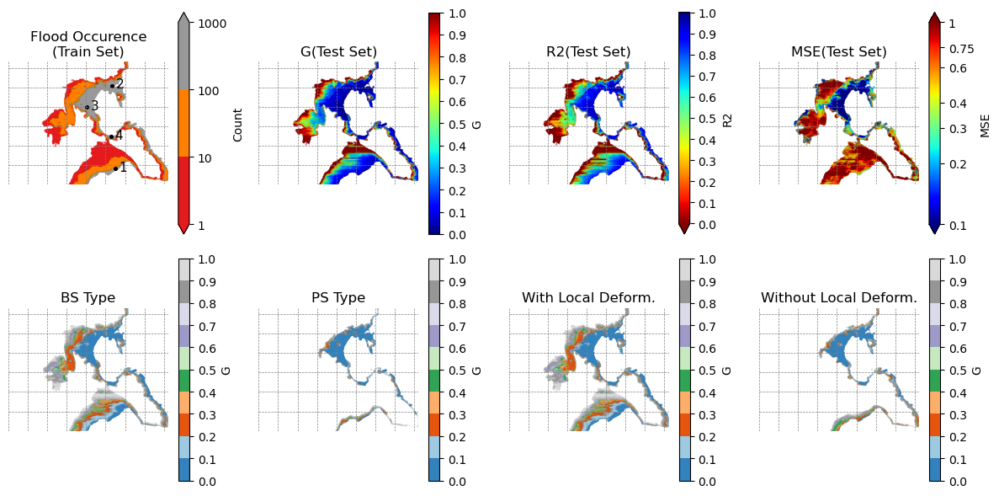

In [2]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import numpy as np
import matplotlib.colors as mplcolors
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from sklearn.metrics import r2_score
import xarray as xr


#select particular representative gauge
reg = 'SR'
list_size = ['961','1773','3669','6941']  
columnname = str(54)
mask_size = list_size[0]
train_size = list_size[1]
idx= np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/lat_lon_idx_{reg}_{mask_size}.npy')
idx_val = pd.read_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/PTHA/_Grid_scores_{train_size}.txt', sep=",")

#add columns to to the idx array
nflood_grids = len(idx)

# Using enumerate to add index to the list of coordinates
control_points = [[37.01,15.29],
            [37.06757,15.28709],
            [37.05266,15.26536],
            [37.03211,15.28632]]

#keep every second element from the list
# control_points = control_points[::2]
coordinates_list = pd.DataFrame(control_points,columns=['lat','lon'])
coordinates_list['id'] = coordinates_list.index+1
CP_list = [29720, 202349, 153030, 94497]
coordinates_list['idx'] = CP_list
coordinates_list['m'] = idx[CP_list, 1]
coordinates_list['n'] = idx[CP_list, 0]

fig, axs = plt.subplots(2, 4, figsize=(12,6))
axs = axs.ravel()

# Plot flood occurence
cmap = plt.get_cmap('Set1',3)
fr = axs[0].scatter(idx[:, 1], idx[:, 0], c=idx_val['count_train']*0.75, s=0.00025, cmap=cmap,norm=mplcolors.LogNorm(vmin=1, vmax=1000)) #multiply by 0.75 as 25% of the data is used for testing
cb = fig.colorbar(fr, ax=axs[0], label='Count',ticks=[1,10,100,1000],extend='both')
#turn off minor ticks on colorbar
cb.ax.yaxis.set_tick_params(which='minor',length=0)
cb.ax.set_yticklabels(['1', '10', '100','1000']) 
axs[0].set_title('Flood Occurence\n(Train Set)')

# Plot control points
axs[0].scatter(coordinates_list['m'], coordinates_list['n'], marker='o', s=7, c='black',alpha=1)
for i, txt in enumerate(coordinates_list['id']):
    if i == 4:
        axs[0].annotate(str(txt), (coordinates_list['m'][i] - 80, coordinates_list['n'][i] - 15) , fontsize=11, color='black')
    else:
        axs[0].annotate(str(txt), (coordinates_list['m'][i] + 30, coordinates_list['n'][i] - 15) , fontsize=11, color='black')


g = axs[1].scatter(idx[:, 1], idx[:, 0], c=idx_val['Gfit'], s=0.00025, cmap='jet', vmin=0, vmax=1)
cb = fig.colorbar(g, ax=axs[1], label='G',ticks=np.linspace(0,1,11))
axs[1].set_title('G(Test Set)')

r2 = axs[2].scatter(idx[:, 1], idx[:, 0], c=idx_val['r2'], s=0.00025, cmap='jet_r', vmin=0, vmax=1)
cb = fig.colorbar(r2, ax=axs[2], label='R2',ticks=np.linspace(0,1,11),extend='min')
axs[2].set_title('R2(Test Set)')

# Plot mse all test that inundate
idx_val['mse']= idx_val['mse']*np.full_like(idx_val['count_test'],(53500-int(train_size))/10000)/idx_val['count_test']
mse = axs[3].scatter(idx[:, 1], idx[:, 0], c=idx_val['mse'], s=0.00025, cmap='jet',norm=mplcolors.LogNorm(vmin=0.1, vmax=1))
cb = fig.colorbar(mse, ax=axs[3], label='MSE',ticks=[0.1,0.2,0.3,0.4,0.6,0.75,1],extend='both')
cb.ax.yaxis.set_tick_params(which='minor',length=0)
cb.ax.set_yticklabels(['0.1', '0.2', '0.3','0.4','0.6','0.75','1']) 
axs[3].set_title('MSE(Test Set)')

# Plot performance variable values
cmap = plt.get_cmap('tab20c', 10)
perf_var = 'Gfit'  # Gfit
count_threshold = 1

# Set NaN for rows where count_test is less than 1
idx_val[perf_var + '_BS'] = np.where(idx_val['count_test_BS'] < count_threshold, np.nan, idx_val[perf_var + '_BS'])
idx_val[perf_var + '_PS'] = np.where(idx_val['count_test_PS'] < count_threshold, np.nan, idx_val[perf_var + '_PS'])
idx_val[perf_var + '_def'] = np.where(idx_val['count_test_def'] < count_threshold, np.nan, idx_val[perf_var + '_def'])
idx_val[perf_var + '_nodef'] = np.where(idx_val['count_test_nodef'] < count_threshold, np.nan, idx_val[perf_var + '_nodef'])

# BS
bs = axs[4].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_BS'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
cbar = fig.colorbar(bs, ax=axs[4],label='G',ticks=np.linspace(0,1,11))
axs[4].set_title('BS Type')

# PS
ps = axs[5].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_PS'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
fig.colorbar(ps, ax=axs[5],label='G',ticks=np.linspace(0,1,11))
axs[5].set_title('PS Type')

# Deformation
deform = axs[6].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_def'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
fig.colorbar(deform, ax=axs[6],label='G',ticks=np.linspace(0,1,11))
axs[6].set_title('With Local Deform.',)

# No Deformation
nondeform = axs[7].scatter(idx[:, 1], idx[:, 0], c=idx_val[perf_var + '_nodef'], s=0.00025, cmap=cmap, vmin=0, vmax=1)
fig.colorbar(deform, ax=axs[7],label='G',ticks=np.linspace(0,1,11))
axs[7].set_title('Without Local Deform.')

# Set axis scale as equal and add gridlines
for ax in axs:
    #keep gridlines but turn off axis borders and ticks
    ax.set_aspect('equal')
    ax.set_axis_off()
    ax.set_xlim([0, max(idx[:, 1])])
    ax.set_ylim([0, max(idx[:, 0])])
    ax.hlines(y=np.arange(0, max(idx[:, 0]), 150), xmin=0, xmax=max(idx[:, 1]), color='grey', linestyle='--', linewidth=0.5)
    ax.vlines(x=np.arange(0, max(idx[:, 1]), 150), ymin=0, ymax=max(idx[:, 0]), color='grey', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.savefig(f'plots/Grid_scores_{train_size}_{reg}.png',dpi=600, bbox_inches='tight', pad_inches=0.1)

Post Processing

In [8]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import numpy as np
import matplotlib.colors as mplcolors
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from sklearn.metrics import r2_score
import xarray as xr

#select particular representative gauge
reg = 'CT'
list_size = ['892','1658','3454','7071']   
columnname = str(38)
mask_size = '892'
train_size = list_size[1]
idx= np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/lat_lon_idx_{reg}_{mask_size}.npy')

#read arrays
eve = 3062

#predictions and post processed predictions
pred_set = np.load('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/out/pred_trainsize7071_testsize0.npy')
pred = pred_set[eve]
del pred_set

post_set = np.load('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/out/postprocessed_trainsize7071_testsize0.npy')
post = post_set[eve]
del post_set

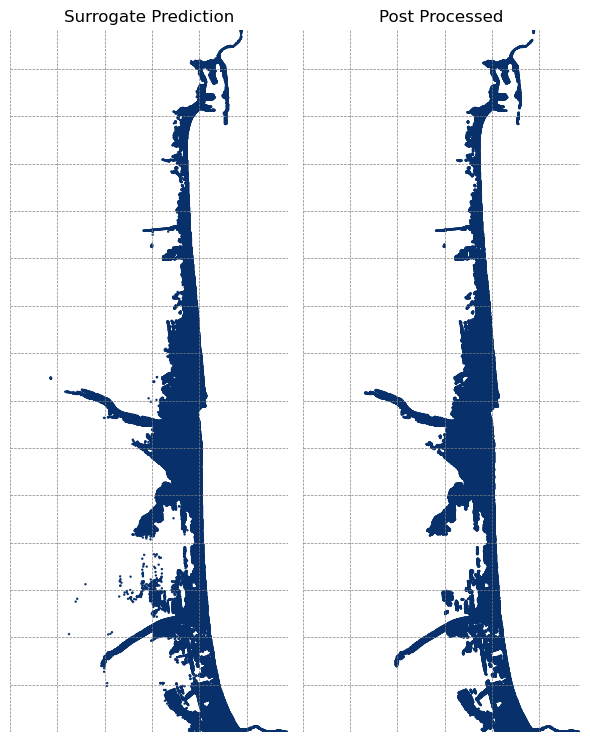

In [14]:
#plot for comparison
fig, axs = plt.subplots(1, 2, figsize=(6,8))
axs = axs.ravel()

#Plot flood occurence
pred = np.where(pred < 0.1, np.nan, pred)
post = np.where(post < 0.1, np.nan, post)
cmap = plt.get_cmap('Blues',1)

fmap_pred = axs[0].scatter(idx[:, 1], idx[:, 0], c=pred, s=0.005,cmap = cmap,)
axs[0].set_title('Surrogate Prediction')

fmap_post = axs[1].scatter(idx[:, 1], idx[:, 0], c=post, s=0.005,cmap = cmap,)
axs[1].set_title('Post Processed')

# Set axis scale as equal and add gridlines
for ax in axs:
    #keep gridlines but turn off axis borders and ticks
    ax.set_aspect('equal')
    ax.set_axis_off()
    ax.set_xlim([0, max(idx[:, 1])])
    ax.set_ylim([0, max(idx[:, 0])])
    ax.hlines(y=np.arange(0, max(idx[:, 0]), 150), xmin=0, xmax=max(idx[:, 1]), color='grey', linestyle='--', linewidth=0.5)
    ax.vlines(x=np.arange(0, max(idx[:, 1]), 150), ymin=0, ymax=max(idx[:, 0]), color='grey', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.savefig(f'plots/Grid_postprocess.png', dpi=600)

Maps - Event Locations

/tmp/ipykernel_2972715/1414379333.py:14: DtypeWarning: Columns (6,7,8,9) have mixed types. Specify dtype option on import or set low_memory=False.
  data_events = pd.read_csv('../../resources/processed/allinfo_eventsBS_PS53550.txt',sep=',')


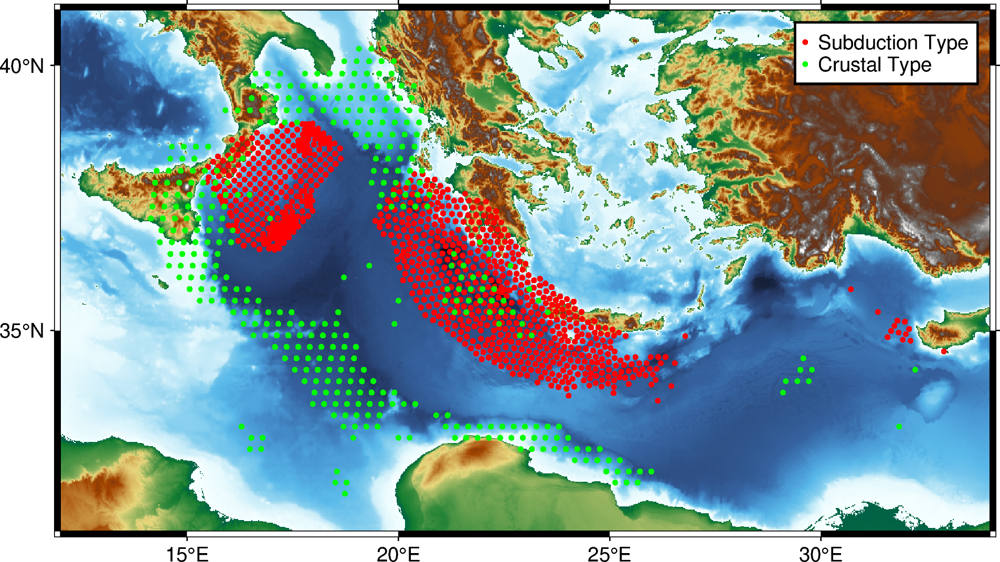

In [1]:
import os
import numpy as np
import pygmt
import pandas as pd

fig = pygmt.Figure()

# Load the grid
grid = pygmt.datasets.load_earth_relief(resolution="01m",region=[12, 34, 31, 41])
fig = pygmt.Figure()
fig.grdimage(grid=grid, projection="M15c", frame="a", cmap="geo")

# Load the earthquake events data
data_events = pd.read_csv('../../resources/processed/allinfo_eventsBS_PS53550.txt',sep=',')


# Filter data by event type
ps_data = data_events[data_events['Type'] == 'PS']
bs_data = data_events[data_events['Type'] == 'BS']

# Create scatter plots for PS and BS data
fig.plot(
    x=ps_data['lon'],
    y=ps_data['lat'],
    style="c0.05",
    pen="1p,red",
    label="Subduction Type",
)
fig.plot(
    x=bs_data['lon'],
    y=bs_data['lat'],
    style="c0.05",
    pen="1p,green",
    label="Crustal Type",
)

# Add a legend	
fig.legend()

# Save or display the map
fig.savefig("/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/results/poster_map_eq.png")
fig.show()


Location WCEE 2024 Paper

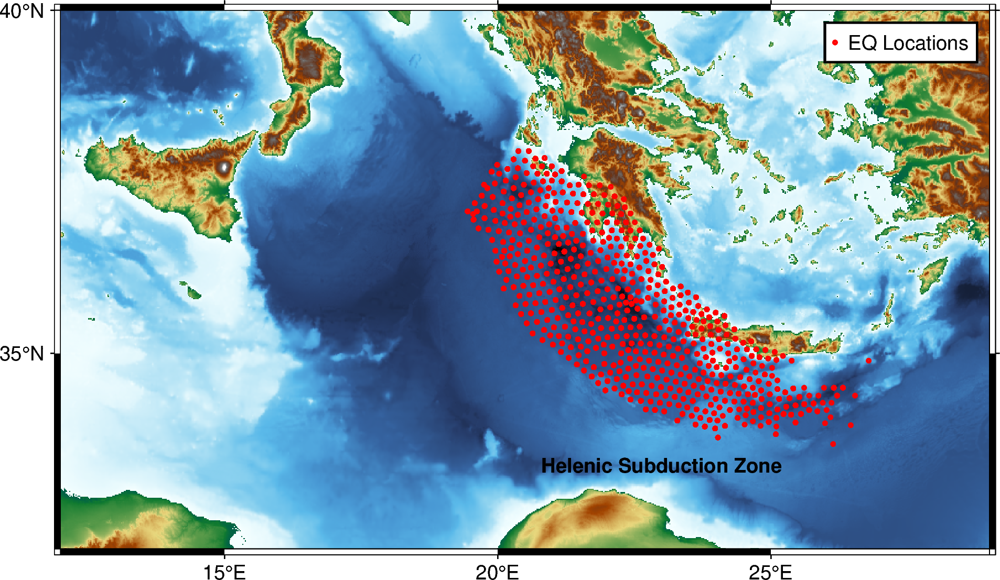

In [1]:
import os
import numpy as np
import pygmt
import pandas as pd

fig = pygmt.Figure()

# Load the grid
grid = pygmt.datasets.load_earth_relief(resolution="01m",region=[12, 29, 32, 40])
fig = pygmt.Figure()
fig.grdimage(grid=grid, projection="M15c", frame="a", cmap="geo")

# Load the earthquake events data
data_events = pd.read_csv('../../data/info/PS_Helenic_sampling_input_CT_41.csv',sep=',')

# Create scatter plots for PS and BS data
fig.plot(
    x=data_events['lon'],
    y=data_events['lat'],
    style="c0.05",
    pen="1p,red",
    label="EQ Locations",
)

#annotate subduction zone with text wrapped at 40 characters

fig.text(
    x=23,
    y=33.3,
    text="Helenic Subduction Zone",
    font="Helvetica-Bold",

)

# Add a legend	
fig.legend()

# Save or display the map
fig.savefig("plots/poster_map_eq.png")
fig.show()


Study Site

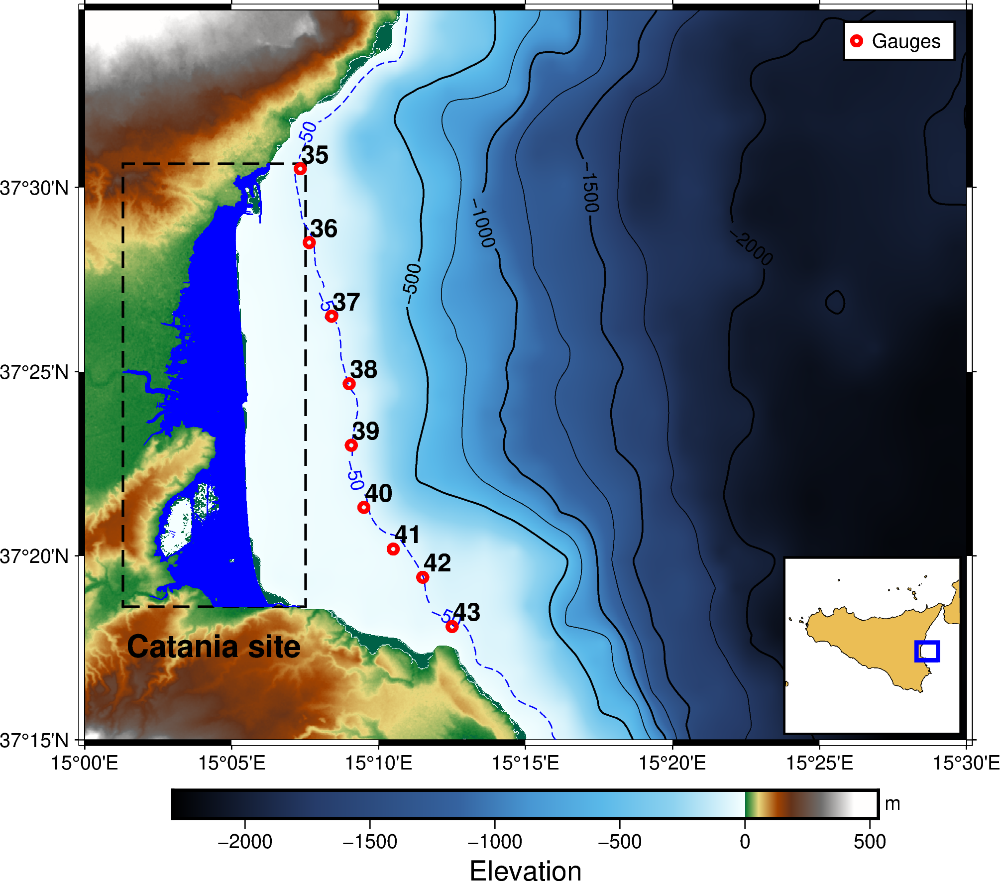

In [5]:
import pygmt
import xarray as xr
import pandas as pd
import numpy as np

#main plot region
region=[15, 15.5,37.25, 37.58]

#read grid lat lon info from text file
grid_info = pd.read_csv('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/lat_lon_idx_CT_1658.txt',sep=',')
#add columns name
grid_info.columns = ['m','n','lat','lon']

# Load the grid
grid_CT = xr.open_dataset('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/CT_defbathy.nc',engine='netcdf4')

grid = pygmt.datasets.load_earth_relief(
    resolution="01s", region=region, registration="gridline"
)

#read offshore points from 
gauges = pd.read_csv('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/resources/raw/pois_depth.csv',sep=',')

CT_gauges = list(range(35,44))

#combine both
selected_gauges =  gauges.iloc[CT_gauges]

fig = pygmt.Figure()

fig.grdimage(grid=grid, frame="a", projection="M15c", cmap="geo",transparency=50,shading=False)

#plot CT and SR grids area as rectangles
fig.plot(
    data = np.array([[float(grid_CT['x'].min().values),
                    float(grid_CT['y'].min().values),
                    float(grid_CT['x'].max()),
                    float(grid_CT['y'].max())]]),
    style='r+s',
    pen= "1p,black,-",)

#plot grids from text file
fig.plot(
        x = grid_info['lon'],
        y = grid_info['lat'],
        transparency=90,
        style="s0.0022c",
        pen="0.005p,blue",
)

# fig.coast(shorelines="2p,gray",region=[14.9, 15.5,37.25, 37.5888],frame="a", projection="M15c",)
fig.grdcontour(grid=grid, interval=250, annotation=500,limit=[-2000, -500])
fig.grdcontour(grid=grid, interval=50, annotation=50,limit=[-56, -49], pen="0.5p,blue,--",label_placement="d3c")

fig.plot(
    x=selected_gauges['lon'],
    y=selected_gauges['lat'],
    style="c0.15",
    pen="2p,red",
    label="Gauges ",
)

#add annotations for gauges
for i in range(len(selected_gauges)):
    fig.text(
        x=selected_gauges['lon'].iloc[i],
        y=selected_gauges['lat'].iloc[i],
        text=selected_gauges['id'].iloc[i],
        font="12p,Helvetica-Bold,black",
        justify="CM",
        offset="0.25c",
    )


fig.text(
    x=15.07,    
    y=37.29,
    text="Catania site",
    font="15p,Helvetica-Bold,black",
    justify="CM",
    offset="0.1c",
)

with fig.inset(position="jBR+w3c/3c+o0.1c", box="+gwhite+p1p"):
    # Plot the Sicily main land in the inset using coast. "U54S/M?" means UTM
    # projection with map width automatically determined from the inset width.
    # Highlight the Japan area in "lightbrown"
    # and draw its outline with a pen of "0.2p".
    fig.coast(
        region=[12, 16, 36, 39],
        projection="U33S/?",
        dcw="IT+glightbrown+p0.2p",
        area_thresh=10000,
    )
    # Plot a rectangle ("r") in the inset map to show the area of the main figure.
    # "+s" means that the first two columns are the longitude and latitude of
    # the bottom left corner of the rectangle, and the last two columns the
    # longitude and latitude of the uppper right corner.
    rectangle = [[region[0], region[2], region[1], region[3]]]
    fig.plot(data=rectangle, style="r+s", pen="2p,blue")

fig.colorbar(frame=["a500", "x+lElevation", "y+lm"])
fig.legend()
# fig.savefig('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/results/poster_regions.png')
fig.show()


Old map region

plot [WARNING]: Length <unit> r not supported - revert to default unit [cm]
plot [WARNING]: 0.15+ not a valid number and may not be decoded properly.


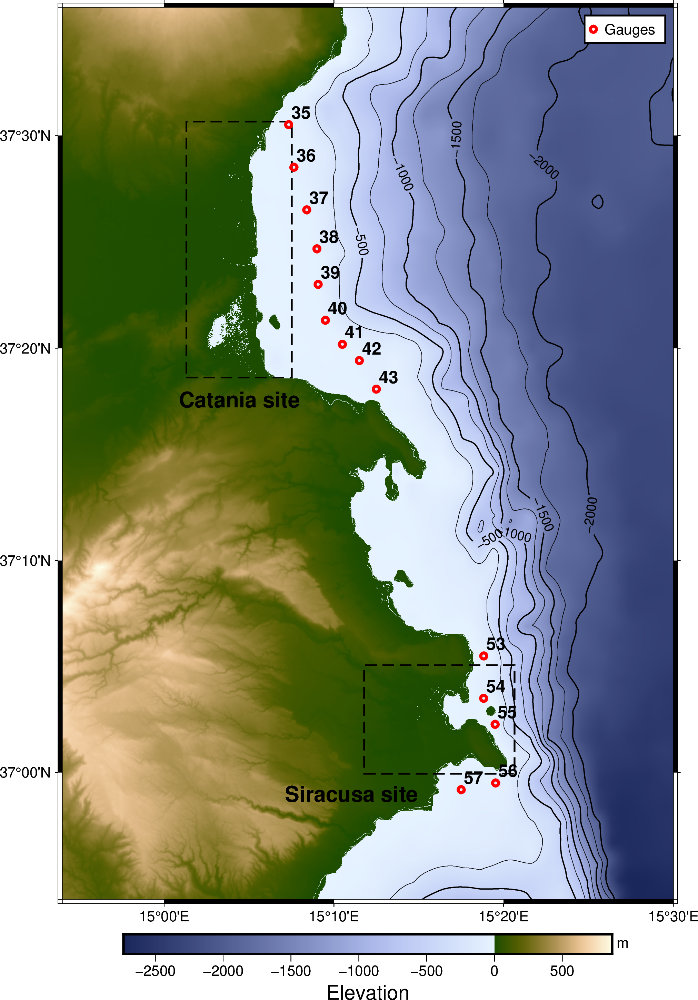

In [1]:
import pygmt
import xarray as xr
import pandas as pd
import numpy as np


# Load the grid
grid_CT = xr.open_dataset('../../data/processed/CT_defbathy.nc',engine='netcdf4')
grid_SR = xr.open_dataset('../../data/processed/SR_defbathy.nc',engine='netcdf4')

grid = pygmt.datasets.load_earth_relief(
    resolution="01s", region=[14.9, 15.5,36.9, 37.6], registration="gridline"
)

#read offshore points from 
gauges = pd.read_csv('../../resources/raw/pois_depth.csv',sep=',')

CT_gauges = list(range(35,44))
SR_gagues = list(range(53,58))

#combine both
selected_gauges =  gauges.iloc[CT_gauges + SR_gagues]

fig = pygmt.Figure()
fig.grdimage(grid=grid, frame="a", projection="M15c", cmap="oleron")
fig.grdcontour(grid=grid, interval=250, annotation=500,limit=[-2000, -10])
# fig.coast(shorelines="2p,gray")

#plot CT and SR grids area as rectangles
fig.plot(
    data = np.array([[float(grid_CT['x'].min().values),
                    float(grid_CT['y'].min().values),
                    float(grid_CT['x'].max()),
                    float(grid_CT['y'].max())]]),
    style='r+s',
    pen= "1p,black,-",)

fig.plot(
    data = np.array([[float(grid_SR['x'].min().values),
                    float(grid_SR['y'].min().values),
                    float(grid_SR['x'].max()),
                    float(grid_SR['y'].max())]]),
    style='r+s',
    pen= "1p,black,-",)

fig.plot(
    x=selected_gauges['lon'],
    y=selected_gauges['lat'],
    style="c0.15+r",
    pen="2p,red",
    label="Gauges ",
)

#add annotations for gauges
for i in range(len(selected_gauges)):
    fig.text(
        x=selected_gauges['lon'].iloc[i],
        y=selected_gauges['lat'].iloc[i],
        text=selected_gauges['id'].iloc[i],
        font="12p,Helvetica-Bold,black",
        justify="CM",
        offset="0.3c",
    )


fig.text(
    x=15.07,    
    y=37.29,
    text="Catania site",
    font="15p,Helvetica-Bold,black",
    justify="CM",
    offset="0.1c",
)

fig.text(
    x=15.18,    
    y=36.98,
    text="Siracusa site",
    font="15p,Helvetica-Bold,black",
    justify="CM",
    offset="0.1c",
)

fig.colorbar(frame=["a500", "x+lElevation", "y+lm"])
fig.legend()
fig.savefig('./plots/pygmt_regions.png')
fig.show()
